<a href="https://colab.research.google.com/github/ghkchan/netlify-test/blob/main/IFC_Space.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
pip install ifcopenshell

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 40.8/40.8 MB 6.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 111.0/111.0 kB 4.5 MB/s eta 0:00:00


In [ ]:
!pip install plotly

In [8]:
# @title input ifc files and generate table with space information
import ifcopenshell
import pandas as pd

pd.set_option("display.max_columns", None)  # Show all columns
pd.set_option("display.max_rows", None)  # Show all rows (optional)

# Function to find associated IfcSpace objects and gather additional information for a given IfcBuildingStorey
def get_spaces_for_storey(ifc_file, storey, file_name):
    spaces = []
    for rel in ifc_file.by_type("IfcRelAggregates"):
        if rel.RelatingObject == storey:
            for obj in rel.RelatedObjects:
                if obj.is_a("IfcSpace"):
                    # Get detailed information for each space
                    space_info = {
                        "FileName": file_name,
                        "StoreyName": storey.Name if storey.Name else "Unnamed Storey",
                        "SpaceName": obj.Name if obj.Name else "Unnamed Space",
                        "GlobalId": obj.GlobalId,
                        "PredefinedType": getattr(obj, 'PredefinedType', None),
                        "ObjectType": getattr(obj, 'ObjectType', None),
                    }
                    # Retrieve all properties from property sets and add them as columns
                    space_info.update(get_property_sets(obj))
                    spaces.append(space_info)
    return spaces

# Function to retrieve all property sets and properties for an IfcSpace
def get_property_sets(space):
    properties_set = {}  # Initialize an empty dictionary to store property set data
    if space.IsDefinedBy:
        for definition in space.IsDefinedBy:
            if definition.is_a('IfcRelDefinesByProperties'):
                property_set = definition.RelatingPropertyDefinition
                property_set_name = property_set.Name

                # Check if property_set is an instance of IfcPropertySet
                if property_set.is_a('IfcPropertySet'):
                    for property_def in property_set.HasProperties:
                        # Use properties_set directly here
                        properties_set[f"{property_set_name}_{property_def.Name}"] = property_def.NominalValue.wrappedValue if property_def.NominalValue else None
                # If property_set is an instance of IfcElementQuantity, handle it differently
                elif property_set.is_a('IfcElementQuantity'):
                    for quantity in property_set.Quantities:  # Access the Quantities attribute
                        # Use properties_set directly here
                        properties_set[f"{property_set_name}_{quantity.Name}"] = quantity.AreaValue if hasattr(quantity, 'AreaValue') else None

    return properties_set  # Return the dictionary containing the property set data

# Function to process multiple IFC files and return a DataFrame
def process_ifc_files(file_paths):
    all_spaces_data = []

    for file_path in file_paths:
        print(f"Processing file: {file_path}")
        ifc_file = ifcopenshell.open(file_path)

        # Retrieve all IfcBuildingStorey objects in the file
        building_storeys = ifc_file.by_type("IfcBuildingStorey")

        for storey in building_storeys:
            # Collect space data for each storey
            all_spaces_data.extend(get_spaces_for_storey(ifc_file, storey, file_path))

    # Create DataFrame from collected data
    df = pd.DataFrame(all_spaces_data)
    return df

# Prompt user to input file paths
file_paths = []
while True:
    file_path = input("Enter the path to an IFC file (or type 'done' to finish): ")
    if file_path.lower() == 'done':
        break
    file_paths.append(file_path)

# Check if any file paths were entered
if file_paths:
    # Process all files and retrieve the storey-space mappings with detailed space info
    df = process_ifc_files(file_paths)

    # Display the DataFrame
    display(df)
else:
    print("No files were entered.")

Enter the path to an IFC file (or type 'done' to finish): (Main Model) PCEC_A_Main_A-_R24_Central Model.ifc
Enter the path to an IFC file (or type 'done' to finish): done
Processing file: (Main Model) PCEC_A_Main_A-_R24_Central Model.ifc


,FileName,StoreyName,SpaceName,GlobalId,PredefinedType,ObjectType,Pset_SpaceCommon_IsExternal,Pset_SpaceCommon_Reference,Pset_SpaceHeaterTypeCommon_Reference,SGPset_Space_ElderlyFriendly,SGPset_Space_HearingEnhancement,Qto_SpaceBaseQuantities_Height,Qto_SpaceBaseQuantities_GrossFloorArea,Qto_SpaceBaseQuantities_NetFloorArea,Qto_SpaceBaseQuantities_GrossCeilingArea,Other_Category,Other_Elderly Friendly,Other_Hearing Enhancement,Other_Larger Accessible,Other_Precaster Accreditation Scheme Accreditation,Other_Sprinkler Protection Automatic,Other_Area Scheme Id,Other_Area Type,Constraints_Level,Dimensions_Computation Height,Dimensions_Area,Dimensions_Perimeter,Identity Data_Balcony,Identity Data_Commercial,Identity Data_Indoor Recreation Space,Identity Data_IsBelowSubLevel,Identity Data_Other,Identity Data_PES,Identity Data_Residential,Identity Data_Name,Identity Data_Number,SGPset_Space_VentilationMode,SGPset_SpaceArea_Verification_AVF_AreaType,SGPset_SpaceArea_Verification_AVF_DevelopmentUse,SGPset_SpaceArea_Verification_AVF_Name,SGPset_SpaceArea_Verification_AVF_BuildingTypology,SGPset_SpaceArea_Verification_AVF_IsInclGFA,Identity Data_AVF_IsInclGFA,Identity Data_AVF_IsInclSGFA,Identity Data_AVF_IsInclSiteCoverage,Identity Data_IsAboveSubLevel,Identity Data_NumberOfFloors,Identity Data_ADDP_Area Type,Identity Data_Blk No.,Text_AVF_AreaType,Text_AVF_BuildingTypology,Text_AVF_DevelopmentUse,Text_AVF_Name,Text_OccupancyLoad,Text_Purpose Group,Text_VentilationMode,SGPset_Space_FireDetectionAndSuppressionSystem,SGPset_SpaceArea_Verification_AVF_Note,SGPset_StrataLot_UnitNumber,Text_AVF_Note,Text_FireDetectionAndSuppressionSystem,Text_Unit Number,SGPset_Space_SmokeControlSystem,Text_SmokeControlSystem,SGPset_Space_LoadingCapacity,Other_LoadingCapacity,SGPset_SpaceArea_Verification_AVF_BonusGFAType,Text_AVF_BonusGFAType,SGPset_Space_OccupancyType,Text_OccupancyType,Text_UnitType
0,(Main Model) PCEC_A_Main_A-_R24_Central Model.ifc,Basement,12,1WEGyv6tnE0Qfezsaa1x5w,USERDEFINED,VEHICULARSERVICEROAD,False,VEHICULARSERVICEROAD 12,VEHICULARSERVICEROAD 12,False,False,None,847.417926,847.417926,847.417926,Areas,False,False,False,False,False,1189657,Building Common Area,Basement,0.0,847.416314,381256.086509,False,False,False,False,False,False,False,VEHICULARSERVICEROAD,12,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,(Main Model) PCEC_A_Main_A-_R24_Central Model.ifc,Basement,330,1WEGyv6tnE0Qfezsaa1x53,NOTDEFINED,AREA_VERIFICATION,False,SMOKE-FREE LOBBY 330,SMOKE-FREE LOBBY 330,False,False,None,11.875000,11.875000,11.875000,Areas,False,False,False,False,False,474618,Building Common Area,Basement,0.0,11.875000,14500.000000,False,False,False,False,False,False,True,SMOKE-FREE LOBBY,330,Mechanical Ventilation,CommonArea,Residential (Non-Landed),Lobby,Condominium,Yes,True,False,False,False,1.0,RESIDENTIAL,Block 8,CommonArea,Condominium,Residential (Non-Landed),Lobby,0,VIII,Mechanical Ventilation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,(Main Model) PCEC_A_Main_A-_R24_Central Model.ifc,Basement,333,1WEGyv6tnE0Qfezsaa1x4b,NOTDEFINED,AREA_VERIFICATION,False,SMOKE-FREE LOBBY 333,SMOKE-FREE LOBBY 333,False,False,None,11.874557,11.874557,11.874557,Areas,False,False,False,False,False,474618,Building Common Area,Basement,0.0,11.874557,14499.813434,False,False,False,False,False,False,True,SMOKE-FREE LOBBY,333,Mechanical Ventilation,CommonArea,Residential (Non-Landed),Lobby,Condominium,Yes,True,False,False,False,1.0,RESIDENTIAL,Block 10,CommonArea,Condominium,Residential (Non-Landed),Lobby,0,VIII,Mechanical Ventilation,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,(Main Model) PCEC_A_Main_A-_R24_Central Model.ifc,Basement,342,1WEGyv6tnE0Qfezsaa1x4V,NOTDEFINED,AREA_VERIFICATION,False,SMOKE-FREE LOBBY 342,SMOKE-FREE LOBBY 342,False,False,None,11.875000,11.875000,11.875000,Areas,False,False,False,False,False,474618,Building Common

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

MessageError: Error: credential propagation was unsuccessful

In [ ]:
# @title Display total area as a barchart
import matplotlib.pyplot as plt
import ipywidgets as widgets
import numpy as np
from IPython.display import display

# Assuming 'df' is the DataFrame created in the previous code block
# Accessing the relevant columns and grouping

# Find all column names that contain "Pset"
pset_columns = [col for col in df.columns if "Pset" or "Storey" in col]

# Create a dropdown list with the Pset columns as options
dropdown = widgets.Dropdown(
    options=pset_columns,
    description="Select Category:",
    disabled=False,
)

# Function to update the plot based on the selected category
def update_plot(change):
    selected_category = change.new

    # Group by the selected category and sum GrossFloorArea
    pset_gross_area = df.groupby(selected_category)['Qto_SpaceBaseQuantities_GrossFloorArea'].sum()

    # Calculate percentages and grand total
    grand_total = pset_gross_area.sum()
    percentages = (pset_gross_area / grand_total) * 100

    # Create the bar plot
    plt.figure(figsize=(10, 6))
    bars = plt.bar(pset_gross_area.index, pset_gross_area.values)  # Get bar objects

    # Highlight the largest bar in red
    largest_bar_index = np.argmax(pset_gross_area.values)
    bars[largest_bar_index].set_color('red')

    # Display quantity and percentage on each bar
    for bar, percentage in zip(bars, percentages):
        height = bar.get_height()
        plt.text(bar.get_x() + bar.get_width() / 2, height,
                 f'{height:.2f}\n({percentage:.1f}%)', ha='center', va='bottom')

    # Display grand total
    plt.text(0.95, 0.95, f'Grand Total: {grand_total:.2f}',
             transform=plt.gca().transAxes, ha='right', va='top')

    plt.xlabel(selected_category)
    plt.ylabel('Total Qto_SpaceBaseQuantities_GrossFloorArea')
    plt.title(f'Total Gross Floor Area per {selected_category}')
    plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability
    plt.tight_layout()  # Adjust layout to prevent labels from overlapping
    plt.show()

# Observe the dropdown for changes and call the update_plot function
dropdown.observe(update_plot, names='value')

# Display the dropdown
display(dropdown)

Dropdown(description='Select Category:', options=('FileName', 'StoreyName', 'SpaceName', 'GlobalId', 'Predefin…

Dropdown(description='Group by:', options=('Pset_SpaceCommon_IsExternal', 'Pset_SpaceCommon_Reference', 'Pset_…

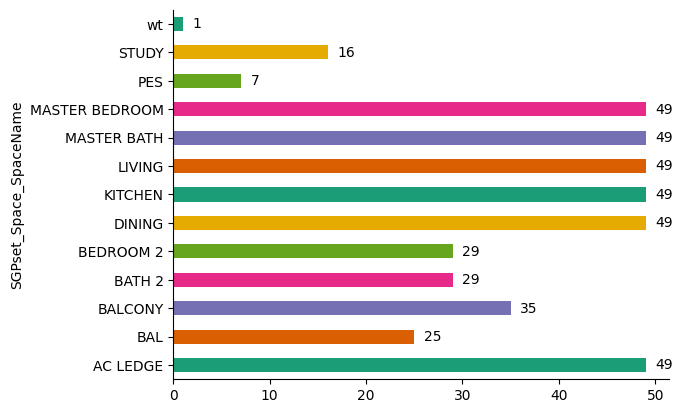

In [ ]:
# @title display no. of spaces as barchart
import ipywidgets as widgets
from IPython.display import display
from matplotlib import pyplot as plt
import seaborn as sns

# ... (Your existing code to load and process the IFC data) ...

# Create a dropdown widget for selecting the groupby column, filtered by "Pset"
groupby_options = [col for col in df.columns if "Pset" in col]
groupby_dropdown = widgets.Dropdown(
    options=groupby_options,
    description="Group by:",
    disabled=False,
)

# Define a function to update the graph based on the selected column
def update_graph(change):
    groupby_column = change['new']
    grouped_data = df.groupby(groupby_column).size()

    # Escape special characters in index for mathtext interpretation
    # Convert index to string before applying replace
    grouped_data.index = grouped_data.index.astype(str).map(lambda x: x.replace('\n', '\\n').replace('_', '\\_'))

    ax = grouped_data.plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
    plt.gca().spines[['top', 'right']].set_visible(False)

    # Add totals to the bars
    for p in ax.patches:
        width = p.get_width()
        plt.text(width + 1,  # Adjust position to the right of the bar
                p.get_y() + p.get_height() / 2,
                '{:1.0f}'.format(width),  # Format the total value
                ha='left', va='center')  # Alignment

    plt.show()

# Observe the dropdown value changes and call update_graph
groupby_dropdown.observe(update_graph, names='value')

# Display the dropdown and initial graph
display(groupby_dropdown)

In [ ]:
# @title Breakdown into storeys
import matplotlib.pyplot as plt
import ipywidgets as widgets
from IPython.display import display

# Assuming 'df' is your DataFrame from previous code

# Get available columns related to occupancy type (you might need to adjust this)
occupancy_type_columns = [col for col in df.columns if "Pset" in col]

# Create a dropdown widget for selecting the occupancy type column
dropdown = widgets.Dropdown(
    options=occupancy_type_columns,
    description="Choose parameter:",
    disabled=False,
)

# Function to update the plot based on the selected column
def update_plot(change):
    selected_column = change.new
    stacked_data = df.groupby([selected_column, 'StoreyName'])['Qto_SpaceBaseQuantities_GrossFloorArea'].sum().unstack()

    fig, ax = plt.subplots(figsize=(10, 6))  # Create figure and axes
    bars = stacked_data.plot(kind='bar', stacked=True, ax=ax)  # Plot on the axes

    plt.xlabel(selected_column)
    plt.ylabel("Total Qto_SpaceBaseQuantities_GrossFloorArea")
    plt.title(f"Stacked Bar Chart of Gross Floor Area by {selected_column} and Storey")
    plt.xticks(rotation=45, ha='right')
    plt.legend(title='StoreyName')
    plt.tight_layout()

# Observe the dropdown for changes and call the update_plot function
dropdown.observe(update_plot, names='value')

# Display the dropdown
display(dropdown)

Dropdown(description='Choose parameter:', options=('Pset_SpaceCommon_Reference', 'Pset_SpaceCommon_IsExternal'…